In [42]:
import numpy as np
import magpylib as magpy
from maggeometry import n_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, get_grid_nonuniformity, make_xy_grid, get_grid_mag_and_nonuniformity
from magpylib.magnet import Cuboid, Cylinder, CylinderSegment
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import pandas as pd

In [43]:
st1 = pd.read_csv('results/4 rings/samwise/2023_07_18_samwise_10G_objective_adaptive_stage1and2opt_4rings_1090T_50.csv')
st1 = np.delete(st1.to_numpy(), [0,1,2], axis=1) #remove first column of indices
x = st1[0]
print (x)
# results2_x = [st1[0]]

[ 13.9338163   16.0980807    2.48949037 190.7487021  146.02657609
   9.96220472   7.7809518  197.00630916  18.03712178   9.18925991
   3.37226829 222.73318945 106.67121136   9.98618377  12.73308728
 217.27081089]


In [44]:
# nominal best n-rings: sw n=4

Br = 1.09e3
mag_dir = (0,0,1)
mirror1_z = True
ringset_1_config = [Br, mag_dir, mirror1_z]

r = 1.09e3
mag_dir = (0,0,1)
mirror2_z = True
ringset_2_config = [Br, mag_dir, mirror2_z]

obj_ring_config=[[*ringset_1_config, *x[0:4]], [*ringset_2_config, *x[4:8]]]
magnets = n_rings(obj_ring_config)

In [45]:
grid_res = 101
grid = make_xy_grid([-10, 10], [-10, 10], grid_res)
grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
print(av_nonuniformity)

3.41479404262686e-09


## dist experiment

In [56]:
grid_res = 101
grid = make_xy_grid([-10, 10], [-10, 10], grid_res)
max_minus = 10
delta_dist = np.linspace(-25, 25, 100)

# vary dist from optimum by dist - da
x3 = x[3]-delta_dist
x4 = x[4]-delta_dist

nonun = []
cf = []
for da in delta_dist:
    cpy_x = np.copy(x)
    cpy_x[3] = x[3] - da
    cpy_x[7] = x[7] - da
    # print(da, cpy_x)
    obj_ring_config=[[*ringset_1_config, *cpy_x[0:4]], [*ringset_2_config, *cpy_x[4:8]]]
    magnets = n_rings(obj_ring_config)
    Gmag, Gnon, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_mag_and_nonuniformity(magnets, grid, grid_res)
    nonun.append(av_nonuniformity)
    cf.append(center_field)
# print(nonun)

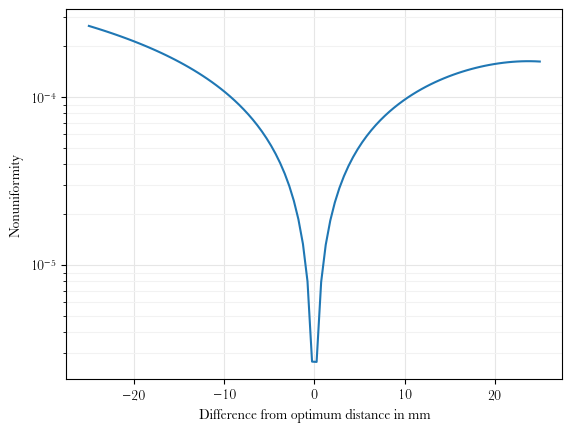

In [57]:
plt.rcParams["font.family"] = 'Baskerville'
plt.yscale('log')
plt.ylabel('Nonuniformity')
plt.xlabel(r'Difference from optimum distance in mm')
plt.grid(color='.9', which='major', axis='both', linestyle='-')
plt.grid(color='.95', which='minor', axis='both', linestyle='-')
plt.plot(delta_dist, nonun)
# plt.legend()
plt.savefig('figs/nringdistdependence2.png', dpi=500)

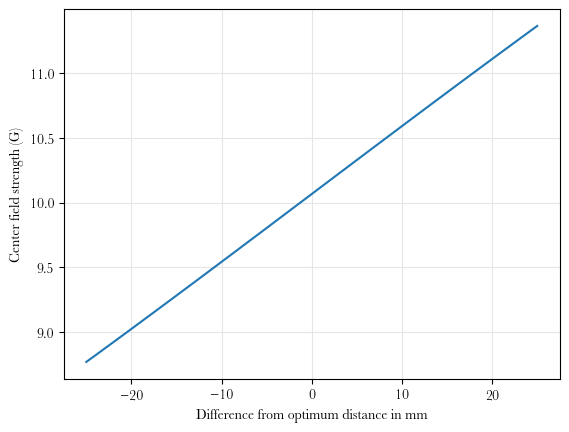

In [59]:
plt.rcParams["font.family"] = 'Baskerville'
# plt.yscale('log')
plt.ylabel('Center field strength (G)')
plt.xlabel(r'Difference from optimum distance in mm')
plt.grid(color='.9', which='major', axis='both', linestyle='-')
plt.grid(color='.95', which='minor', axis='both', linestyle='-')
plt.plot(delta_dist, cf)
# plt.legend()
plt.savefig('figs/nringdistdependence_cf.png', dpi=500)

In [ ]:
#ring_set_position is a sequence of [innerrad, width, thickness, dist]
def noisy_rings(mean_Br, sd_Br, ring_set_position, N_seg, show=False):
    assert mean_Br > 1e2
    magnets = magpy.Collection()
    for pos in ring_set_position:
        ring_top = magpy.Collection()
        ring_bot = magpy.Collection()
        innerrad, width, thickness, dist = pos
        for i in range(N_seg):
            Br_top = np.random.default_rng().normal(mean_Br, sd_Br)
            ring_top += CylinderSegment(magnetization=(0, 0, Br_top),
                                       dimension=(innerrad, innerrad + width, thickness, i*angle, (i+1)*angle),
                                       position = (0, 0, +dist))
            Br_bot = np.random.default_rng().normal(mean_Br, sd_Br)
            ring_bot += CylinderSegment(magnetization=(0, 0, Br_bot),
                                       dimension=(innerrad, innerrad + width, thickness, i*angle, (i+1)*angle),
                                       position = (0, 0, -dist))
            
        magnets.add(ring_top).add(ring_bot)
#     .add(ring_bot)
    user_defined_style = {
        'show': True,
        "size": 0.1,
        'color': {
            'transition': 0,
            'mode': 'tricolor',
            'middle': 'white',
            'north': 'magenta',
            'south': 'turquoise',
        },
        "mode": "arrow+color",
    }
    magpy.defaults.display.style.magnet.magnetization = user_defined_style
    if show:
        magpy.show(magnets, backend='plotly')
    return magnets

# magnets = noisy_rings(1.09e3, 100, [[30, 1, 2, 1], [50, 1, 2, 10]], 90)

In [11]:
import numpy as np
import magpylib as magpy
from magpylib.magnet import Cuboid, Cylinder, CylinderSegment
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt


#ring_set_position is a sequence of [innerrad, width, thickness, dist]
def noisy_rings(mean_Br, sd_Br, ring_set_position, N_seg, show=False):
    assert mean_Br > 1e2
    magnets = magpy.Collection()
    angle = 360/N_seg
    for pos in ring_set_position:
        ring_top = magpy.Collection()
        ring_bot = magpy.Collection()
        innerrad, width, thickness, dist = pos
        for i in range(N_seg):
            Br_top = np.random.default_rng().normal(mean_Br, sd_Br)
            ring_top += CylinderSegment(magnetization=(0, 0, Br_top),
                                       dimension=(innerrad, innerrad + width, thickness, i*angle, (i+1)*angle),
                                       position = (0, 0, +dist))
            Br_bot = np.random.default_rng().normal(mean_Br, sd_Br)
            ring_bot += CylinderSegment(magnetization=(0, 0, Br_bot),
                                       dimension=(innerrad, innerrad + width, thickness, i*angle, (i+1)*angle),
                                       position = (0, 0, -dist))
            
        magnets.add(ring_top).add(ring_bot)
#     .add(ring_bot)
    user_defined_style = {
        'show': True,
        "size": 0.1,
        'color': {
            'transition': 0,
            'mode': 'tricolor',
            'middle': 'white',
            'north': 'magenta',
            'south': 'turquoise',
        },
        "mode": "arrow+color",
    }
    magpy.defaults.display.style.magnet.magnetization = user_defined_style
    if show:
        magpy.show(magnets, backend='plotly')
    return magnets

# magnets = noisy_rings(1.09e3, 100, [[30, 1, 2, 1], [50, 1, 2, 10]], 90)

Using the best 2 ring geometry

On x-axis:
Maximum B-field: 14.59 G
Central B-field: 14.589 G
Min nonuniformity: 0.0
Max nonuniformity:0.00012727938247218904


On y-axis:
Maximum B-field: 14.589 G
Central B-field: 14.589 G
Min nonuniformity: 0.0
Max nonuniformity:1.8456255587274023e-05


On z-axis:
Maximum B-field: 14.589 G
Central B-field: 14.589 G
Min nonuniformity: 0.0
Max nonuniformity:4.9010494346507556e-05


Uniform region width with threshold 1e-06: x = 0.015 cm, y = 0.11 cm, z = 0.065 cm


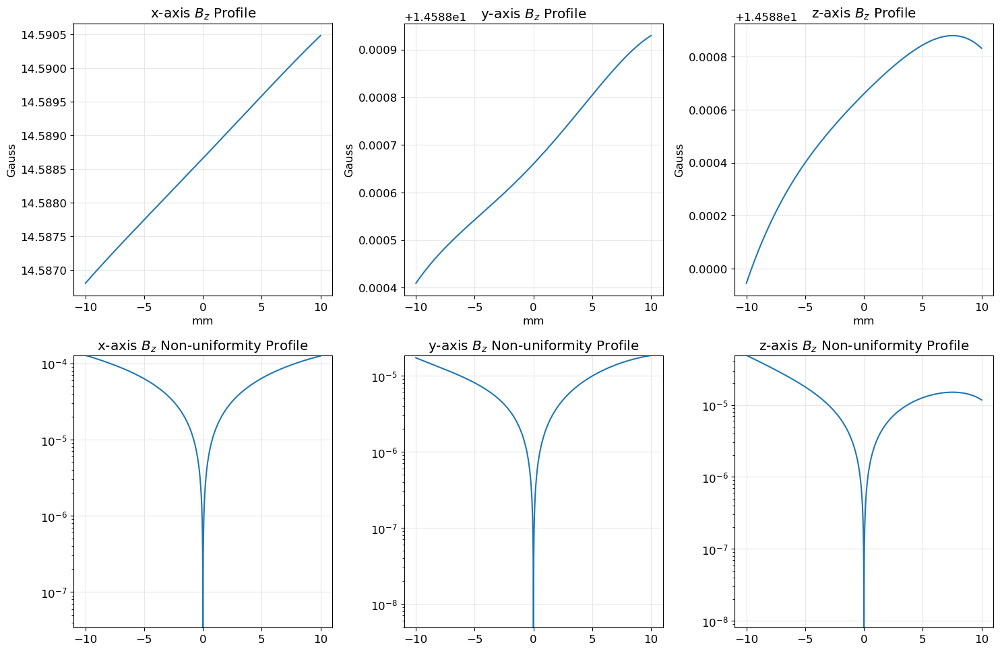

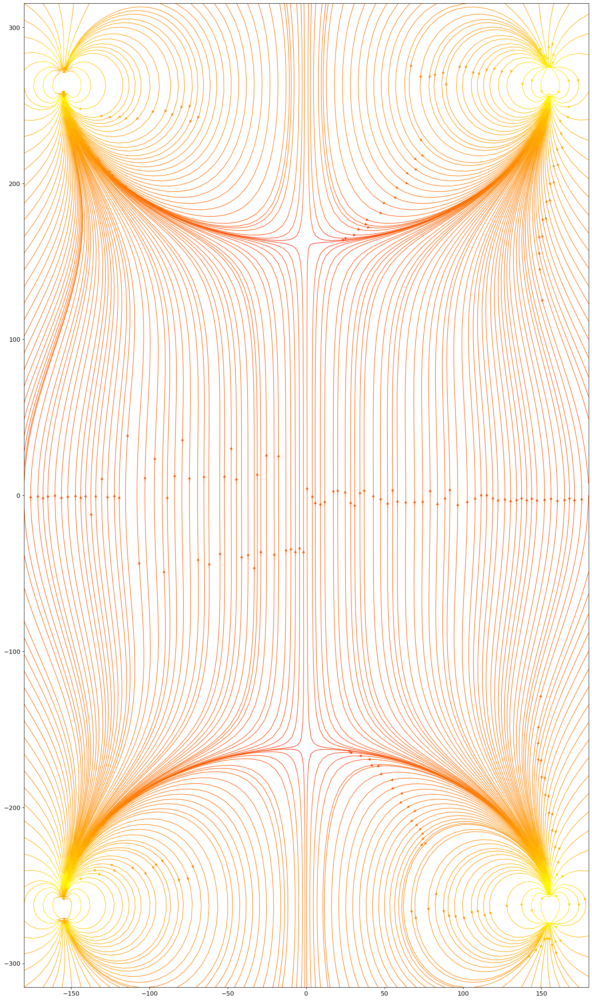

In [7]:
x = [1.50000000e+02, 1.00000000e+01, 2.00000000e+01, 2.62805985e+02]
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad, width, thickness, dist = x
Br = 1.09e3
s = 0.01

magnets = noisy_rings(Br, s*Br, [x], 36)

sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad, 1.2*innerrad]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

Using best 4 ring geometry

On x-axis:
Maximum B-field: 9.535 G
Central B-field: 9.533 G
Min nonuniformity: 0.0
Max nonuniformity:0.00032919550779114627


On y-axis:
Maximum B-field: 9.537 G
Central B-field: 9.533 G
Min nonuniformity: 0.0
Max nonuniformity:0.0004508929713037992


On z-axis:
Maximum B-field: 9.538 G
Central B-field: 9.533 G
Min nonuniformity: 0.0
Max nonuniformity:0.0006012281904452568


Uniform region width with threshold 1e-06: x = 0.013 cm, y = 0.01 cm, z = 0.006 cm


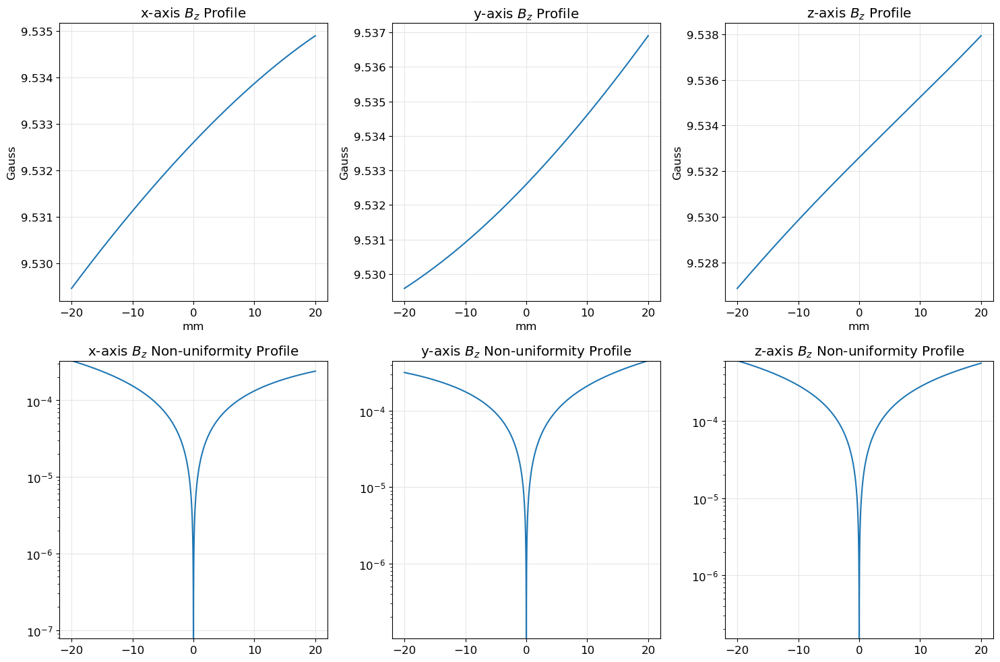

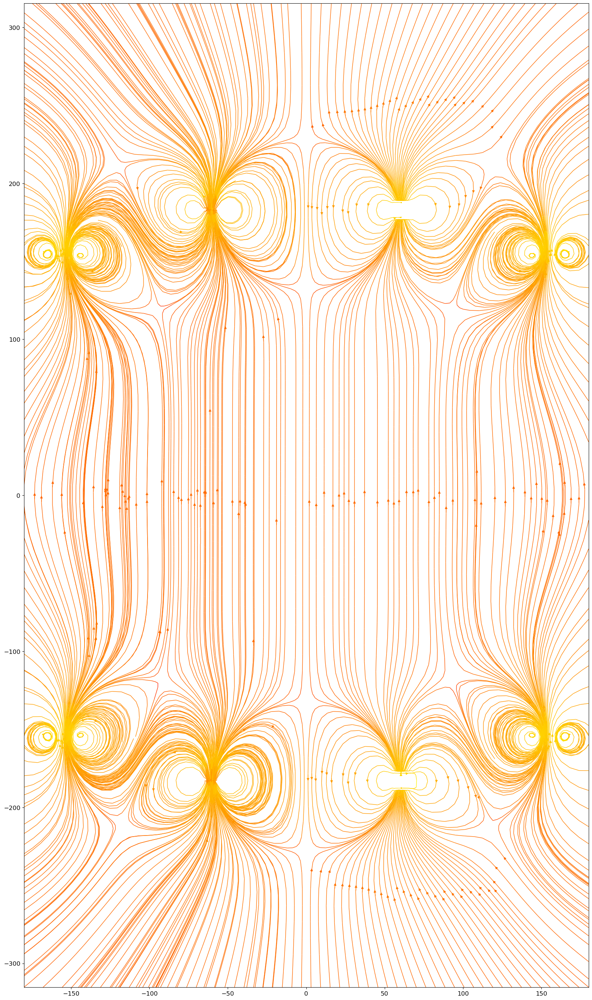

In [14]:
xs = [144.38226051, 51.11048466, 19.94272085,  2., 155.70613803, 183.10542199]
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad1, innerrad2, width, thickness, dist1, dist2 = xs
x4 = [[innerrad1, width, thickness, dist1], [innerrad2, width, thickness, dist2]]

Br = 1.09e3
s = 0.01

magnets = noisy_rings(Br, s*Br, x4, 10)

sens_len = 20
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad, 1.2*innerrad]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

On x-axis:
Maximum B-field: 9.515 G
Central B-field: 9.515 G
Min nonuniformity: 0.0
Max nonuniformity:9.081782960032246e-06


On y-axis:
Maximum B-field: 9.515 G
Central B-field: 9.515 G
Min nonuniformity: 0.0
Max nonuniformity:1.2869889734346398e-05


On z-axis:
Maximum B-field: 9.516 G
Central B-field: 9.515 G
Min nonuniformity: 0.0
Max nonuniformity:3.4925488242573645e-05


Uniform region width with threshold 1e-06: x = 1.994 cm, y = 1.2 cm, z = 0.751 cm


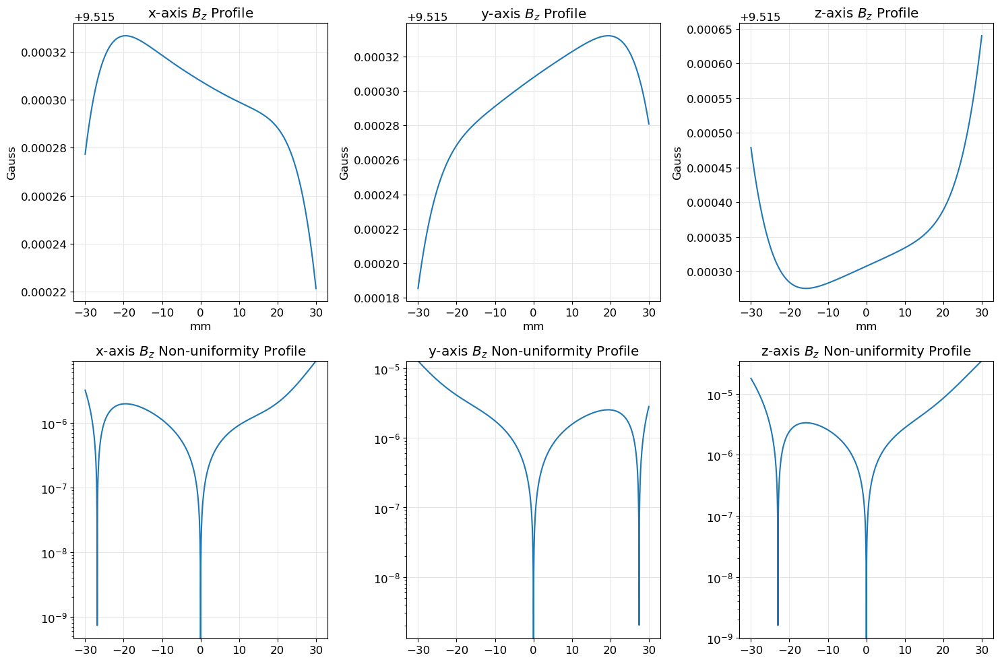

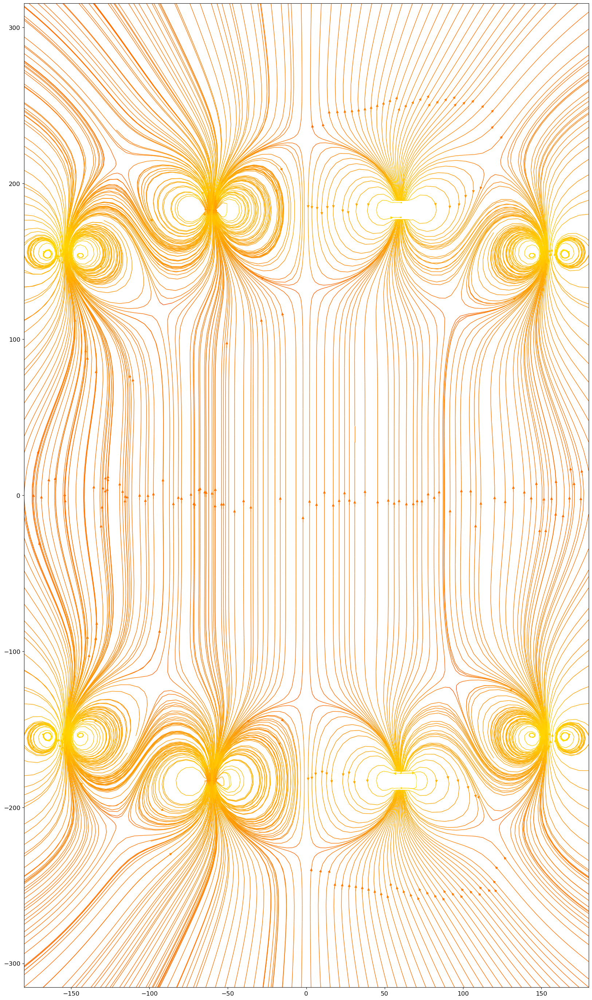

In [16]:
xs = [144.38226051, 51.11048466, 19.94272085,  2., 155.70613803, 183.10542199]
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad1, innerrad2, width, thickness, dist1, dist2 = xs
x4 = [[innerrad1, width, thickness, dist1], [innerrad2, width, thickness, dist2]]

Br = 1.09e3
s = 0.0001

magnets = noisy_rings(Br, s*Br, x4, 10)

sens_len = 30
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad, 1.2*innerrad]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

On x-axis:
Maximum B-field: 9.515 G
Central B-field: 9.515 G
Min nonuniformity: 0.0
Max nonuniformity:4.2006194208073465e-07


On y-axis:
Maximum B-field: 9.515 G
Central B-field: 9.515 G
Min nonuniformity: 0.0
Max nonuniformity:4.200619420807005e-07


On z-axis:
Maximum B-field: 9.515 G
Central B-field: 9.515 G
Min nonuniformity: 0.0
Max nonuniformity:3.0429798087312473e-06




IndexError: index -5001 is out of bounds for axis 0 with size 5000

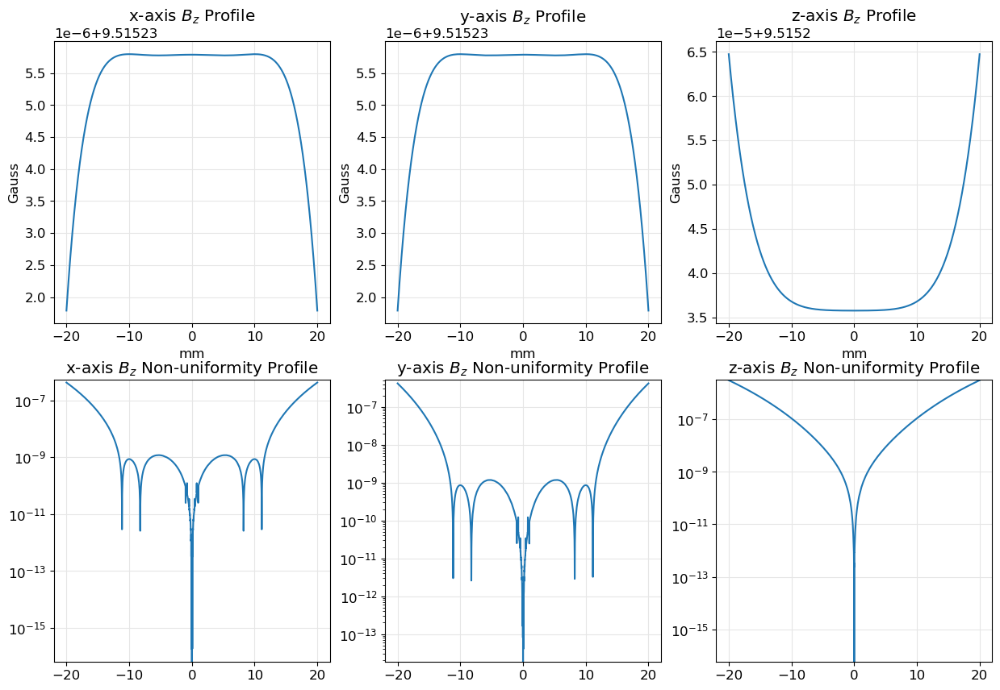

In [17]:
xs = [144.38226051, 51.11048466, 19.94272085,  2., 155.70613803, 183.10542199]
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad1, innerrad2, width, thickness, dist1, dist2 = xs
x4 = [[innerrad1, width, thickness, dist1], [innerrad2, width, thickness, dist2]]

Br = 1.09e3
s = 0.0

magnets = noisy_rings(Br, s*Br, x4, 10)

sens_len = 20
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad, 1.2*innerrad]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])